In [56]:
import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno# as misno
import plotly.express as px
import geopandas as gpd
from housing_prices import MrClean

from matplotlib.ticker import PercentFormatter

plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [57]:
# Read & Clean from previous page
df = MrClean('data/king_county_houses.csv').declutter()

In [161]:
df.query('id==2402100895')

,grade,condition,floors,bedrooms,bathrooms,waterfront,year_built,year_renovated,selling_price,selling_date,...,sqft_above,sqft_basement,sqft_living15,sqft_lot15,zipcode,lat,lon,selling_price_scale,price_per_sqft_lot,price_per_sqft_living
id,,,,,,,,,,,,,,,,,,,,,
2402100895,7,5,1.00,33,1.75,False,1947,0,640000.00,2014-06-25,...,1040,580,1330,4700,98103,47.69,-122.33,5.81,106.67,395.06


In [138]:
# add price per lot and price per living area
df['price_per_sqft_lot']    = df.selling_price / df.sqft_lot
df['price_per_sqft_living'] = df.selling_price / df.sqft_living

In [139]:
df.head()

,grade,condition,floors,bedrooms,bathrooms,waterfront,year_built,year_renovated,selling_price,selling_date,...,sqft_above,sqft_basement,sqft_living15,sqft_lot15,zipcode,lat,lon,selling_price_scale,price_per_sqft_lot,price_per_sqft_living
id,,,,,,,,,,,,,,,,,,,,,
7129300520,7,3,1.00,3,1.00,False,1955,0,221900.00,2014-10-13,...,1180,0,1340,5650,98178,47.51,-122.26,5.35,39.27,188.05
6414100192,7,3,2.00,3,2.25,False,1951,1991,538000.00,2014-12-09,...,2170,400,1690,7639,98125,47.72,-122.32,5.73,74.29,209.34
5631500400,6,3,1.00,2,1.00,False,1933,0,180000.00,2015-02-25,...,770,0,2720,8062,98028,47.74,-122.23,5.26,18.00,233.77
2487200875,7,5,1.00,4,3.00,False,1965,0,604000.00,2014-12-09,...,1050,910,1360,5000,98136,47.52,-122.39,5.78,120.80,308.16
1954400510,8,3,1.00,3,2.00,False,1987,0,510000.00,2015-02-18,...,1680,0,1800,7503,98074,47.62,-122.05,5.71,63.12,303.57


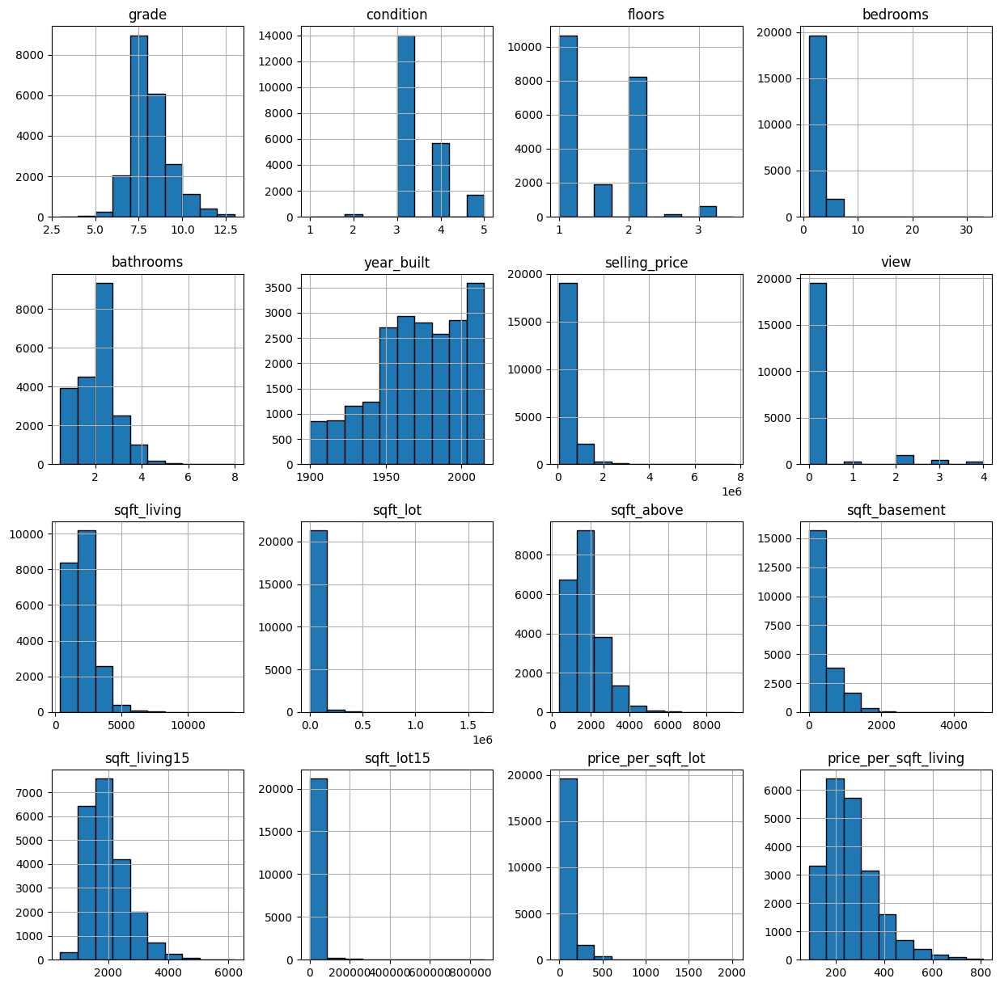

In [149]:
hist = df.drop(['selling_price_scale', 'lat', 'lon', 'zipcode', 'selling_date', 'year_renovated'], axis=1)
hist.hist(figsize=(15,15), edgecolor = 'black');

In [76]:
df.corr()

,grade,condition,floors,bedrooms,bathrooms,waterfront,year_built,year_renovated,selling_price,selling_date,...,sqft_living,sqft_lot,sqft_above,sqft_basement,sqft_living15,sqft_lot15,zipcode,lat,lon,selling_price_scale
grade,1.00,-0.15,0.46,0.36,0.67,0.08,0.45,0.02,0.67,-0.04,...,0.76,0.11,0.76,0.17,0.71,0.12,-0.19,0.11,0.20,0.70
condition,-0.15,1.00,-0.26,0.03,-0.13,0.02,-0.36,-0.06,0.04,-0.05,...,-0.06,-0.01,-0.16,0.17,-0.09,-0.00,0.00,-0.02,-0.11,0.04
floors,0.46,-0.26,1.00,0.18,0.50,0.02,0.49,0.00,0.26,-0.02,...,0.35,-0.00,0.52,-0.24,0.28,-0.01,-0.06,0.05,0.13,0.31
bedrooms,0.36,0.03,0.18,1.00,0.51,-0.00,0.16,0.02,0.31,-0.02,...,0.58,0.03,0.48,0.30,0.39,0.03,-0.15,-0.01,0.13,0.34
bathrooms,0.67,-0.13,0.50,0.51,1.00,0.06,0.51,0.05,0.53,-0.03,...,0.76,0.09,0.69,0.28,0.57,0.09,-0.20,0.02,0.22,0.55
waterfront,0.08,0.02,0.02,-0.00,0.06,1.00,-0.02,0.07,0.26,0.00,...,0.10,0.02,0.07,0.08,0.08,0.03,0.03,-0.01,-0.04,0.17
year_built,0.45,-0.36,0.49,0.16,0.51,-0.02,1.00,-0.20,0.05,-0.00,...,0.32,0.05,0.42,-0.13,0.33,0.07,-0.35,-0.15,0.41,0.08
year_renovated,0.02,-0.06,0.00,0.02,0.05,0.07,-0.20,1.00,0.12,-0.02,...,0.05,0.00,0.02,0.06,0.00,0.00,0.06,0.03,-0.06,0.11
selling_price,0.67,0.04,0.26,0.31,0.53,0.26,0.05,0.12,1.00,-0.00,...,0.70,0.09,0.61,0.32,0.59,0.08,-0.05,0.31,0.02,0.89
selling_date,-0.04,-0.05,-0.02,-0.02,-0.03,0.00,-0.00,-0.02,-0.00,1.00,...,-0.03,0.01,-0.03,-0.02,-0.03,0.00,0.00,-0.03,-0.01,-0.01


<Axes: >

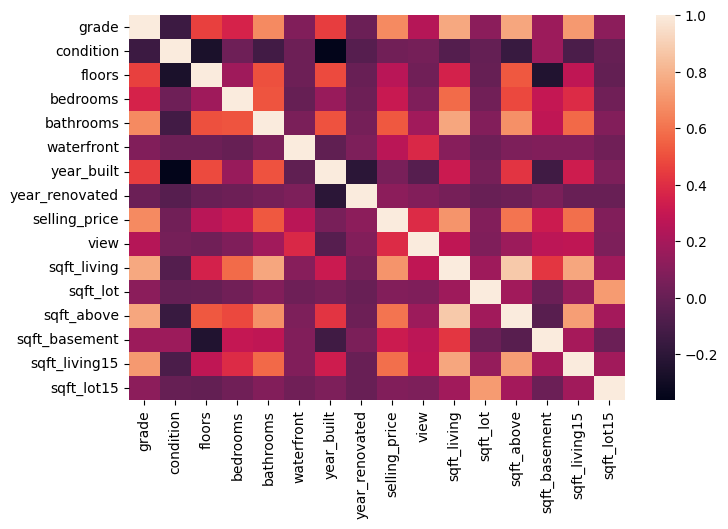

In [109]:
# visualizing correlations
df2 = df.drop(columns=['lat', 'lon', 'zipcode', 'selling_date', 'selling_price_scale'])
sns.heatmap(df2.corr())

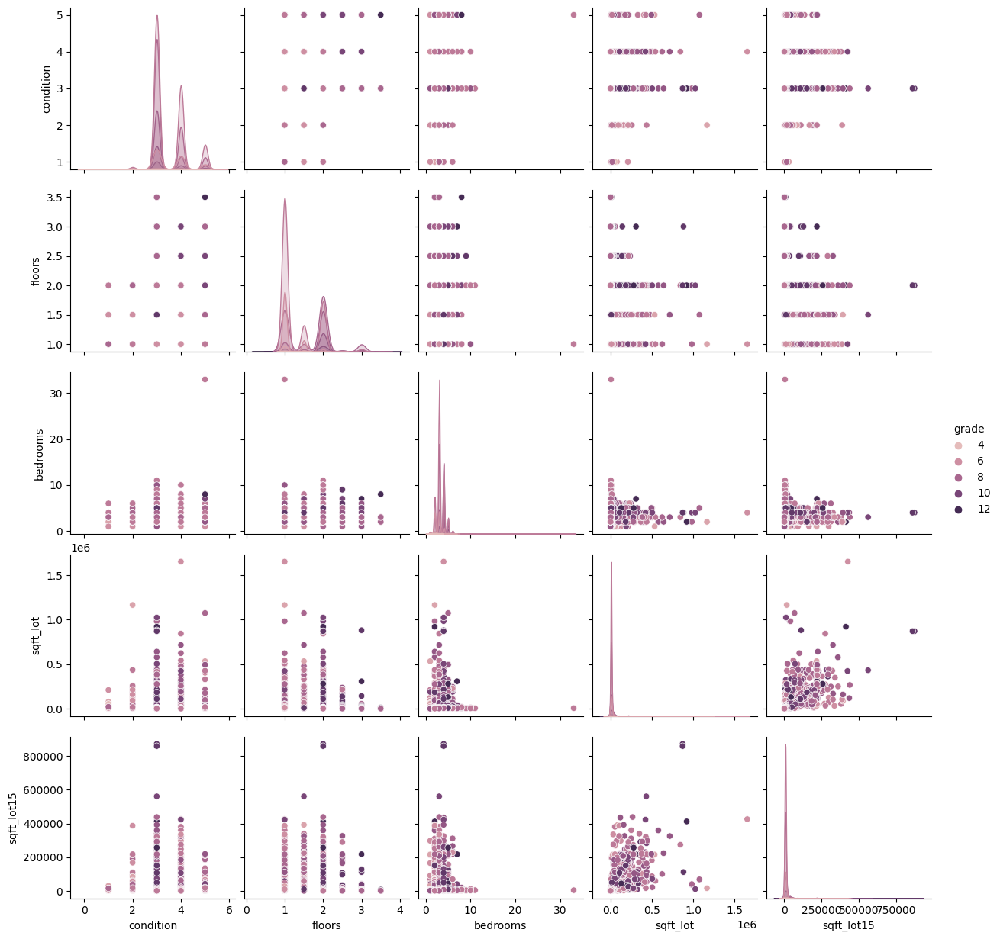

In [99]:

columns_to_plot = ['grade', 'condition', 'floors', 'bedrooms', 'sqft_lot', 'sqft_lot15']
#columns_to_plot = ['year_built', 'zipcode', 'sqft_lot']
sns.pairplot(df[columns_to_plot], hue='grade') # , diag_kind="kde", kind="reg",

In [110]:
df.describe()

,grade,condition,floors,bedrooms,bathrooms,year_built,year_renovated,selling_price,selling_date,view,sqft_living,sqft_lot,sqft_above,sqft_basement,sqft_living15,sqft_lot15,zipcode,lat,lon,selling_price_scale
count,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00,21597.00
mean,7.66,3.41,1.49,3.37,2.12,1971.00,68.76,540296.57,2014-10-29 04:20:38.171968512,0.23,2080.32,15099.41,1788.60,285.75,1986.62,12758.28,98077.95,47.56,-122.21,5.67
min,3.00,1.00,1.00,1.00,0.50,1900.00,0.00,78000.00,2014-05-02 00:00:00,0.00,370.00,520.00,370.00,0.00,399.00,651.00,98001.00,47.16,-122.52,4.89
25%,7.00,3.00,1.00,3.00,1.75,1951.00,0.00,322000.00,2014-07-22 00:00:00,0.00,1430.00,5040.00,1190.00,0.00,1490.00,5100.00,98033.00,47.47,-122.33,5.51
50%,7.00,3.00,1.50,3.00,2.25,1975.00,0.00,450000.00,2014-10-16 00:00:00,0.00,1910.00,7618.00,1560.00,0.00,1840.00,7620.00,98065.00,47.57,-122.23,5.65
75%,8.00,4.00,2.00,4.00,2.50,1997.00,0.00,645000.00,2015-02-17 00:00:00,0.00,2550.00,10685.00,2210.00,550.00,2360.00,10083.00,98118.00,47.68,-122.12,5.81
max,13.00,5.00,3.50,33.00,8.00,2015.00,2015.00,7700000.00,2015-05-27 00:00:00,4.00,13540.00,1651359.00,9410.00,4820.00,6210.00,871200.00,98199.00,47.78,-121.31,6.89
std,1.17,0.65,0.54,0.93,0.77,29.38,364.04,367368.14,NaN,0.76,918.11,41412.64,827.76,439.82,685.23,27274.44,53.51,0.14,0.14,0.23


In [101]:
# Prince range per number of bedrooms
df[['bedrooms', 'selling_price']].groupby('bedrooms').selling_price.agg(['min', 'max'])

,min,max
bedrooms,,
1,80000.00,1250000.00
2,78000.00,3280000.00
3,82000.00,3800000.00
4,100000.00,4490000.00
5,133000.00,7060000.00
6,175000.00,7700000.00
7,280000.00,3200000.00
8,340000.00,3300000.00
9,450000.00,1400000.00


<Axes: xlabel='selling_price', ylabel='Density'>

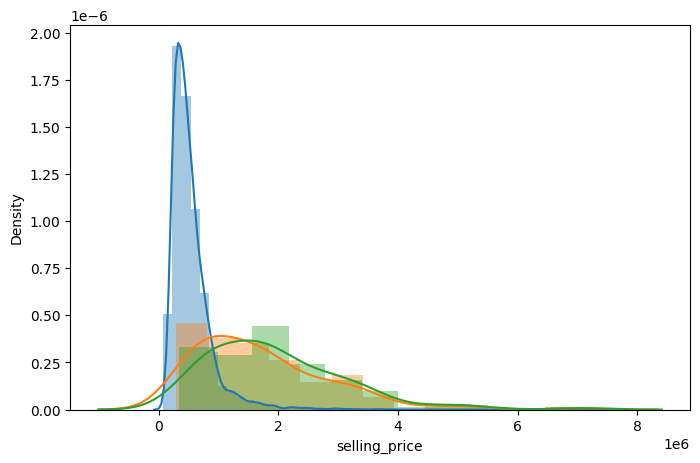

In [107]:
sns.distplot(df.selling_price)
sns.distplot(df.query('waterfront == True').selling_price)
sns.distplot(df.query('waterfront == True and bedrooms > 2').selling_price)

In [11]:
df[['zipcode', 'selling_price']].groupby('zipcode').selling_price.agg(['min', 'max', 'mean'])

,min,max,mean
zipcode,,,
98001,100000.00,850000.00,281194.87
98002,95000.00,389000.00,234284.04
98003,128000.00,950000.00,294111.28
98004,425000.00,7060000.00,1356523.99
98005,400000.00,1960000.00,810289.70
...,...,...,...
98177,245560.00,3800000.00,676419.39
98178,90000.00,1700000.00,310612.76
98188,110000.00,707000.00,289078.35


# Larger Properties are further from the city center
- size of markers is lot size
- color is zipcode

In [113]:
fig = px.scatter_mapbox(df,
    lat='lat',
    lon='lon',
    hover_name='selling_price',
    color='zipcode', #grade, view, waterfrontm #condition
    size='sqft_lot'
)
fig.update_layout(
    title = 'Houses for Sale in King County, WA, USA',
    geo_scope="usa",
    width=700,
    height=600,
    mapbox_style='carto-positron',
    margin={"r":0,"t":0,"l":0,"b":0}
)
fig.update_geos(fitbounds='locations')
fig.show()

In [162]:
fig = px.scatter_mapbox(df,
    lat='lat',
    lon='lon',
    hover_name='selling_price',
    color='price_per_sqft_living', #grade, view, waterfrontm #condition
    #size='sqft_lot'
)
fig.update_layout(
    title = 'Houses for Sale in King County, WA, USA',
    geo_scope="usa",
    width=700,
    height=600,
    mapbox_style='carto-positron',
    margin={"r":0,"t":0,"l":0,"b":0}
)
fig.update_geos(fitbounds='locations')
fig.show()

In [105]:
larry = df.query('waterfront == True')
larry.sort_values(by=['selling_price', 'bedrooms']).head(10)

,grade,condition,floors,bedrooms,bathrooms,waterfront,year_built,year_renovated,selling_price,selling_date,...,sqft_living,sqft_lot,sqft_above,sqft_basement,sqft_living15,sqft_lot15,zipcode,lat,lon,selling_price_scale
id,,,,,,,,,,,,,,,,,,,,,
2781600195,5,3,1.00,1,1.00,True,1935,0,285000.00,2014-11-17,...,1060,54846,1060,0,2258,31762,98070,47.47,-122.44,5.45
3523029041,5,4,1.00,2,0.75,True,1943,0,290000.00,2014-10-09,...,440,8313,440,0,880,26289,98070,47.43,-122.51,5.46
222029026,6,5,1.00,2,0.75,True,1947,0,340000.00,2014-09-17,...,1060,48292,560,500,750,80201,98070,47.43,-122.51,5.53
2923039243,6,3,1.00,4,1.00,True,1972,0,340000.00,2014-11-13,...,1200,11834,1200,0,1670,47462,98070,47.46,-122.44,5.53
2013802030,7,3,1.00,3,2.00,True,1955,0,357000.00,2014-09-11,...,2460,53882,2460,0,2660,32625,98198,47.38,-122.33,5.55
2123039032,5,5,1.00,1,0.75,True,1936,0,369900.00,2014-10-27,...,760,10079,760,0,1230,14267,98070,47.47,-122.44,5.57
7631800110,10,3,2.00,3,2.50,True,1984,0,380000.00,2014-09-18,...,1980,17342,1580,400,2060,17313,98166,47.46,-122.37,5.58
5216200090,6,4,1.00,2,1.00,True,1928,0,385000.00,2014-06-16,...,830,26329,830,0,2030,27338,98070,47.40,-122.42,5.59
221029019,7,3,2.00,3,2.50,True,1919,0,400000.00,2015-04-28,...,2090,32718,1550,540,1200,192268,98070,47.33,-122.51,5.60


In [142]:
fig = px.scatter_mapbox(df,
    lat='lat',
    lon='lon',
    hover_name='selling_price',
    color='price_per_sqft_living', #grade, view, waterfrontm #condition
#    size='sqft_lot'
)
fig.update_layout(
    title = 'Houses for Sale in King County, WA, USA',
    geo_scope="usa",
    width=700,
    height=600,
    mapbox_style='carto-positron',
    margin={"r":0,"t":0,"l":0,"b":0}
)
fig.update_geos(fitbounds='locations')
fig.show()

In [122]:
# most expensive neighborhoods by sqft living
abc=df[['zipcode', 'price_per_sqft_living']].groupby('zipcode').mean().sort_values(by='price_per_sqft_living', ascending=False)#.head(10)
abc

KeyError: "['price_per_sqft_living'] not in index"

In [123]:
# avg selling_price per zipcode
# poor neighborhoods
df[['zipcode', 'selling_price']].groupby('zipcode').mean().sort_values(by='selling_price').head(5)

,selling_price
zipcode,
98002,234284.04
98168,240328.37
98032,251296.24
98001,281194.87
98148,284908.60


In [124]:
kingcounty = gpd.read_file('data/Zipcodes_for_King_County_and_Surrounding_Area___zipcode_area.geojson')

<Axes: >

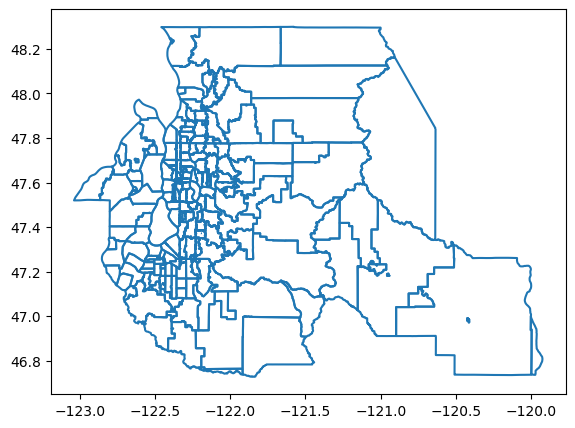

In [18]:
kingcounty.boundary.plot()

In [125]:

kingcounty = gpd.read_file('data/Zipcodes_for_King_County_and_Surrounding_Area___zipcode_area.geojson')

df['selling_price_scale'] = np.log10(df.selling_price)

dfmap = df[['selling_price','zipcode']]

# Create a choropleth map
fig4 = px.choropleth_mapbox(dfmap, 
    geojson=kingcounty,  # Replace with the path to your GeoJSON file
    locations='zipcode',  # Column in your DataFrame with zip codes
    featureidkey='properties.ZIPCODE',  # Key in the GeoJSON file to match with zip codes
    color='selling_price',  # Column in your DataFrame for coloring the map   
    title='Selling Prices by Zip Code in King County',
    mapbox_style="carto-positron",
    zoom=8, center = {"lat": 47.608013, "lon": -122.335167},
)
fig4.update_layout(
        width=700,
        height=500,
        margin={"r":0,"t":0,"l":0,"b":0},
)
fig4.update_geos(fitbounds="locations")
fig4.show()

<Axes: xlabel='zipcode', ylabel='selling_price'>

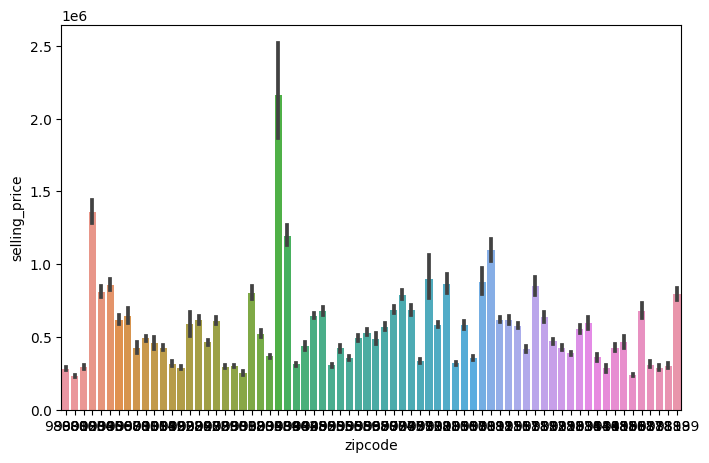

In [98]:
sns.barplot(x=df.zipcode, y=df.selling_price)

## Bining Data

In [ ]:

#pd.qcut(df.selling_price, 6, precision=1)
#pd.cut(df.year_built, bins=8, right=True)

df.year_built_range = pd.cut(df.year_built, bins=10, right=True)
[f"{int(s.left)}–{int(s.right)}" for s in sorted(df.year_built_range.unique())]

In [ ]:
df.selling_price_range = pd.cut(df.selling_price, bins=[0, 250_000, 500_000, 1_000_000, 5_000_000], right=False)
[f"{int(s.left)}-{int(s.right)}" for s in sorted(df.selling_price_range.unique())]